# Notebook to generate manifold for scRNA 

**Developed by** : Srivalli Kolla

**Würzburg Institute for Systems Immunology - JMU-Würzburg**

**Created on** : April 11, 2024

**Modified on** : April 12,2024

# Importing packages

In [19]:
import bbknn
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from pywaffle import Waffle
import matplotlib.pyplot as plt

# Setting up environment

In [20]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'magma', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
PIL                 10.2.0
annoy               NA
appnope             0.1.4
asttokens           NA
bbknn               1.6.0
cffi                1.16.0
comm                0.2.1
cycler              0.12.1
cython_runtime      NA
dateutil            2.8.2
debugpy             1.8.1
decorator           5.1.1
executing           2.0.1
h5py                3.10.0
igraph              0.10.8
ipykernel           6.29.3
jedi                0.19.1
joblib              1.3.2
kiwisolver          1.4.5
leidenalg           0.10.2
llvmlite            0.42.0
louvain             0.8.1
matplotlib          3.8.3
matplotlib_inline   0.1.6
mpl_toolkits        NA
natsort             8.4.0
numba               0.59.0
numpy               1.26.4
packaging           23.2
pandas              2.2.1
parso               0.8.3
patsy               0.5.6
pickleshare         0.7.5
pkg_resources       NA
platformdirs        4.2.0
prompt_toolkit      3.0.42
psutil       

# Data import

In [3]:
vascular = sc.read_h5ad("../Output/normalized_vascular.h5ad")
vascular

AnnData object with n_obs × n_vars = 195395 × 33538
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets', 'percent_chrY'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45', 'Mt', 'ribo', 'processed_gene_names', 'ensembl_gene_id', 'start_position', 'end_position', 'chromosome_name'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'sqrt_norm'

## Preprocessing

### Normalization

In [4]:
vascular_raw = vascular.copy()

#Making sqrt_counts as a layer
vascular.X = vascular.layers['sqrt_norm'].copy()

### Highly variable gene calculation

In [5]:
sc.pp.highly_variable_genes(
    vascular,
    flavor= "seurat_v3",
    layer= "counts",
    n_top_genes= 7000,
    subset= True
)
vascular

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 195395 × 7000
    obs: 'NRP', 'age_group', 'cell_source', 'cell_type', 'donor', 'gender', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states', 'Used', 'doublet_scores', 'predicted_doublets', 'percent_chrY'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45', 'Mt', 'ribo', 'processed_gene_names', 'ensembl_gene_id', 'start_position', 'end_position', 'chromosome_name', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cell_type_colors', 'hvg'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'sqrt_norm'

### Dimensionality reduction

In [6]:
sc.pp.pca(vascular, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(vascular, use_rep = "X_pca", n_neighbors = 50, metric = 'minkowski', random_state = 1786)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:19)
computing neighbors


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:39)


### Batch correction

In [7]:
bbknn_donor = bbknn.bbknn(vascular, batch_key = 'sample', approx = True, copy = True)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:05:04)


# Data visualization

## Overall visualization

In [21]:
sc.tl.umap(bbknn_donor, min_dist = 0.3, spread = 4, random_state = 1789)
sc.pl.umap(bbknn_donor, frameon= False , color= ['n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'source', 'type', 'cell_states', 'doublet_scores', 'predicted_doublets', 'percent_chrY'])
plt.savefig('../Output/umap_plot.png')

computing UMAP


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/umap/umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:55)


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

<Figure size 1200x1200 with 0 Axes>

In [9]:
#sc.pl.umap(bbknn_donor, frameon = False, color = ['Vwf', 'Myh11', 'Rgs4', 'Kcnj8', 'C1qa', 'Cd3e', 'Trem2', 'Adipoq', 'Nrxn1', 'Msln'], size = 0.6, legend_fontsize = 8, ncols = 4, cmap = 'RdPu')

## Covariate visualization

### Doublet score per sample

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


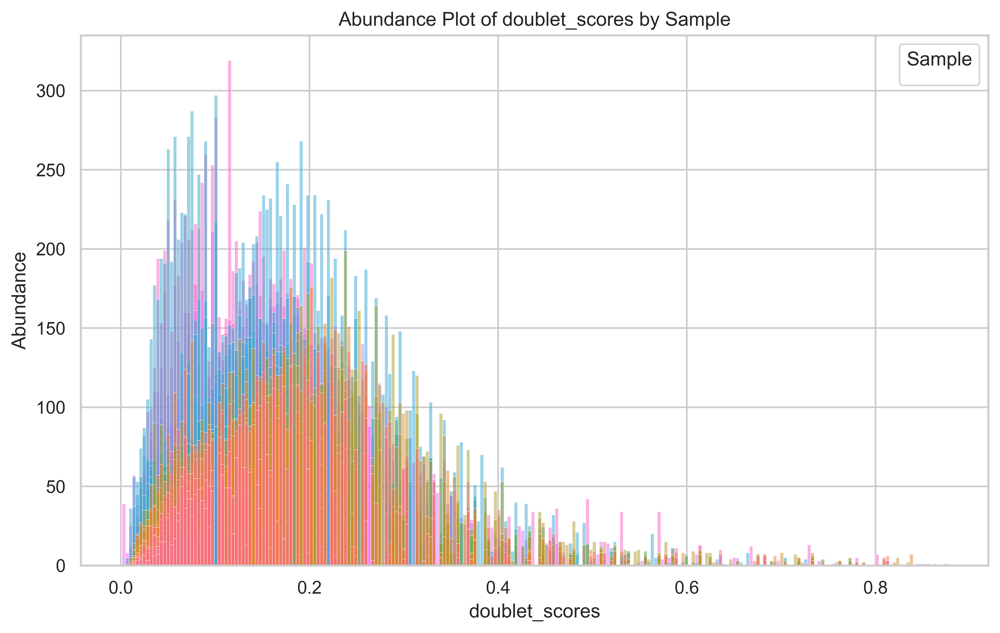

In [10]:
sns.set(style="whitegrid")
covariate_to_visualize = 'doublet_scores'

plt.figure(figsize=(10, 6))
sns.histplot(data=vascular.obs, x=covariate_to_visualize, hue='sample', stat='count', common_norm=False)
plt.xlabel(covariate_to_visualize)
plt.ylabel('Abundance')
plt.title(f'Abundance Plot of {covariate_to_visualize} by Sample')
plt.legend(title='Sample', loc='upper right')

plt.savefig('../output/doublet_scores-histplot.png', dpi=300) 
plt.show()

### Doublet score of each sample

In [11]:
sns.set(style="whitegrid")
covariate_to_visualize = 'doublet_scores'

sample_names = vascular.obs['sample'].unique()
num_samples = len(sample_names)
color_palette = sns.color_palette("Set1", n_colors=num_samples)

g = sns.FacetGrid(vascular.obs, col="sample", col_wrap=10,height=4, palette=color_palette)
g.map_dataframe(sns.histplot, x=covariate_to_visualize, stat='count', common_norm=False)

g.set_axis_labels(covariate_to_visualize, 'Abundance')
g.set_titles(col_template="{col_name}")
g.add_legend(title='Sample', loc='upper right')

plt.tight_layout()
plt.savefig('../output/doublet_scores-facetgrid_plot.png', dpi=300)  
plt.show()

### Counts per sample

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


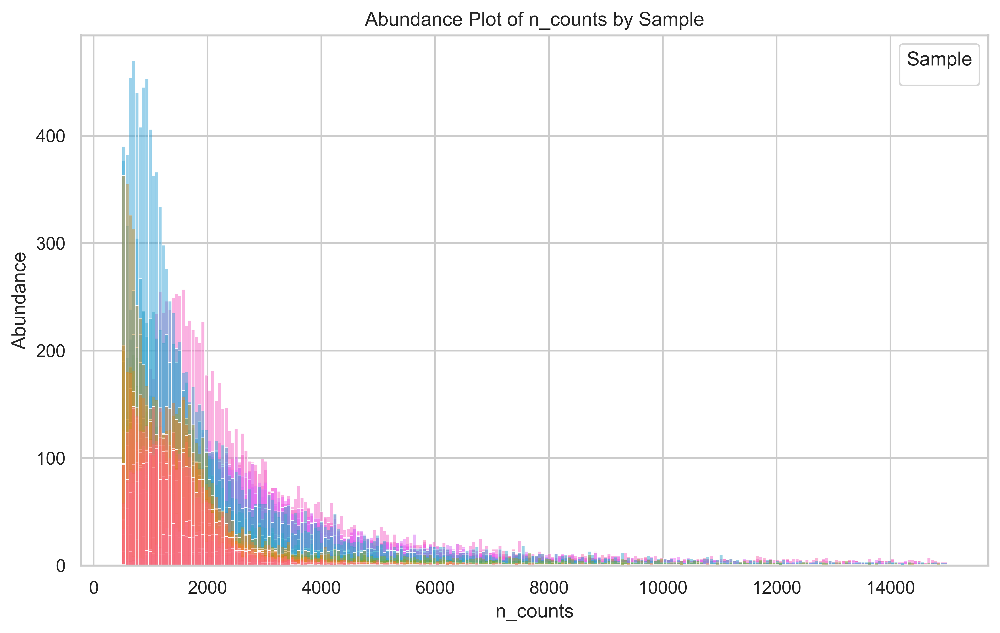

In [12]:
sns.set(style = "whitegrid")
covariate_to_visualize = 'n_counts'

plt.figure(figsize = (10, 6))
sns.histplot(data = vascular.obs, x = covariate_to_visualize, hue = 'sample', stat = 'count', common_norm = False)
plt.xlabel(covariate_to_visualize)
plt.ylabel('Abundance')
plt.title(f'Abundance Plot of {covariate_to_visualize} by Sample')
plt.legend(title = 'Sample', loc = 'upper right')

plt.savefig('../output/n-counts-histplot.png', dpi=300) 
plt.show()

### UMI plot per sample

In [16]:
sample_names = vascular.obs['sample'].unique()

# Calculate the number of rows and columns for the subplot layout
num_rows = 30
num_cols = 5

# Create a single figure with multiple panels arranged in a grid
fig, axs = plt.subplots(num_rows, num_cols, figsize=(50, 20))

# Flatten the axs array to make it easier to iterate
axs = axs.flatten()

# Define a color palette for the lines
color_palette = plt.cm.get_cmap('tab10')

# Loop through each sample and generate the UMI count plot in a separate panel
for idx, sample_name in enumerate(sample_names):
    # Select cells belonging to the current sample
    mask = vascular.obs['sample'] == sample_name
    sample_vascular = vascular[mask].copy()

    # Sort cells by UMI counts in descending order
    sample_vascular.obs['umi_counts'] = sample_vascular.X.sum(axis=1)
    sample_vascular = sample_vascular[sample_vascular.obs['umi_counts'].argsort()[::-1]]

    # Generate the UMI count plot in the current panel
    ax = axs[idx]
    color = color_palette(idx)
    ax.plot(range(1, len(sample_vascular) + 1), sample_vascular.obs['umi_counts'], marker='o', linestyle='-', label=sample_name, color=color, linewidth=1)
    ax.set_xlabel('Cell Rank')
    ax.set_ylabel('UMI Count')
    ax.set_title(f'UMI Count per Cell for Sample: {sample_name}')
    ax.set_xlim(0, 60000)
    ax.set_ylim(0, 1500)  # Set x-axis limit
    ax.legend()

# Adjust layout and save the figure
plt.tight_layout()
output_filename = '../Output/umi_count_subplot.png'
plt.savefig(output_filename)

# Show the figure
plt.show()


/var/folders/m6/j4jl72rj0pl7_bbwngtxl9ym0000gn/T/ipykernel_74467/3302511634.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab10')
/var/folders/m6/j4jl72rj0pl7_bbwngtxl9ym0000gn/T/ipykernel_74467/3302511634.py:38: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()
